In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 100

In [ ]:
!unzip '/content/drive/MyDrive/drinks.zip' 
    

Archive:  /content/drive/MyDrive/drinks.zip
  inflating: Finalize/images/test/0394c800-1a1f-4e70-9f82-c0ce1615afab.jpg  
  inflating: Finalize/images/test/03ffbce3-149d-4752-824d-138dec4065a2.jpg  
  inflating: Finalize/images/test/10a743af-bdaf-4486-be1c-41a269e7f8b1.jpg  
  inflating: Finalize/images/test/2892d76b-c3e1-42b6-8f22-94761135f2ff.jpg  
  inflating: Finalize/images/test/2db88c37-9e0f-44c7-aaaf-5a339da8e94b.jpg  
  inflating: Finalize/images/test/5fbf4d4b-3aca-49b5-aa25-f5680640a646.jpg  
  inflating: Finalize/images/test/8647c73d-bb46-46d0-9dec-8d789df06fc5.jpg  
  inflating: Finalize/images/test/9618db50-df08-4fb7-987d-bf0fe3858517.jpg  
  inflating: Finalize/images/test/d8cbac6f-f667-4c2e-bb6a-5add85ba9b18.jpg  
  inflating: Finalize/images/test/e39a39a0-05ac-4c40-b5f9-99ae117d1ca6.jpg  
  inflating: Finalize/images/train/01308197-3145-4fc4-8abf-ee2c4a906f22.jpg  
  inflating: Finalize/images/train/029399ed-97f9-4aeb-adfb-0a6a921aff50.jpg  
  inflating: Finalize/images/t

In [ ]:
print("No.of images in training folder:",len(os.listdir('/content/Finalize/images/train')))
print("No.of images in test folder:",len(os.listdir('/content/Finalize/images/test')))

#print(len(os.listdir('/content/Finalize/labels/test')))
#print(len(os.listdir('/content/Finalize/labels/train')))

No.of images in training folder: 90
No.of images in test folder: 10


In [ ]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else: 
        print('File already present, skipping download...')

In [ ]:
class_names = ['Coca_Cola', 'Sprite', 'Pepsi', 'Mountain_Dew','7UP','Fanta']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 20))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

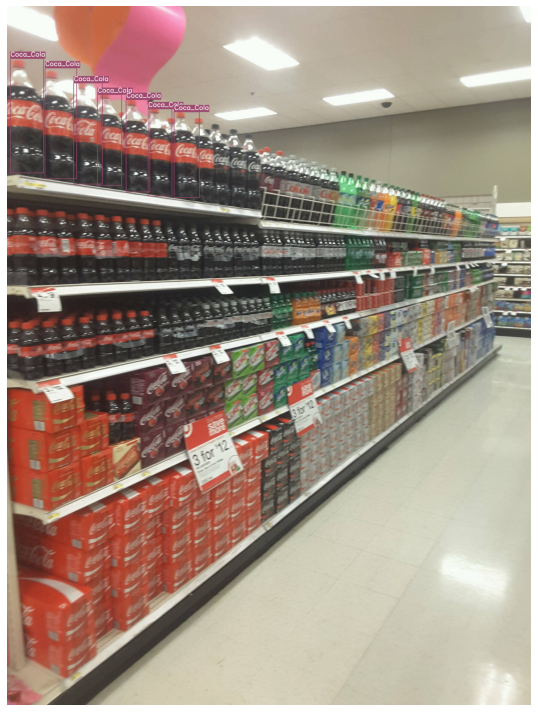

In [ ]:
# Visualize a few training images.
plot(
    image_paths='/content/Finalize/images/train/*', 
    label_paths='/content/Finalize/labels/train/*',
    num_samples=1,
)

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 14441, done.
remote: Counting objects: 100% (70/70), done.
remote: Compressing objects: 100% (47/47), done.
remote: Total 14441 (delta 42), reused 44 (delta 22), pack-reused 14371
Receiving objects: 100% (14441/14441), 13.57 MiB | 15.29 MiB/s, done.
Resolving deltas: 100% (9943/9943), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 182 kB 37.7 MB/s 
     |████████████████████████████████| 62 kB 1.5 MB/s 
     |████████████████████████████████| 1.6 MB 61.7 MB/s 


In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
train: weights=yolov5s.pt, cfg=, data=/content/drive/MyDrive/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-30-g342fe05 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

confusion_matrix.png				   R_curve.png
events.out.tfevents.1670655054.2999bcf9e809.472.0  results.csv
F1_curve.png					   results.png
hyp.yaml					   train_batch0.jpg
labels_correlogram.jpg				   train_batch1.jpg
labels.jpg					   train_batch2.jpg
opt.yaml					   val_batch0_labels.jpg
P_curve.png					   val_batch0_pred.jpg
PR_curve.png					   weights
['runs/train/results_2/val_batch0_pred.jpg']


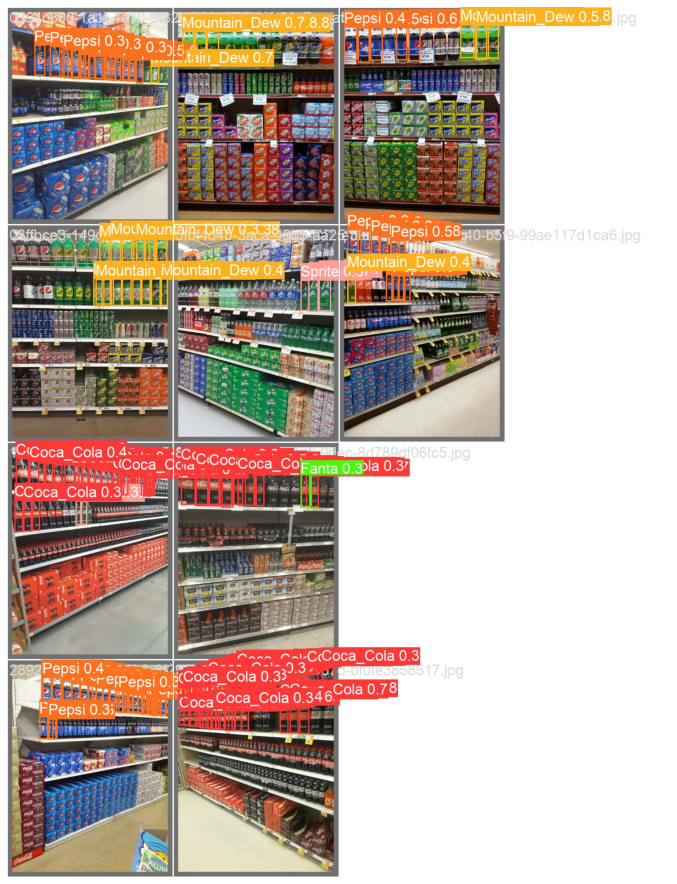

In [ ]:
show_valid_results(RES_DIR)

In [ ]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 385), started 1:31:34 ago. (Use '!kill 385' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
import torch
model = torch.hub.load('ultralytics/yolov5', 'custom','/content/yolov5/runs/train/results_2/weights/best.pt')  # yolov5n - yolov5x6 official model
#                                            'custom', 'path/to/best.pt')  # custom model

# Images
im = '/content/Finalize/images/test/0394c800-1a1f-4e70-9f82-c0ce1615afab.jpg'  # or file, Path, URL, PIL, OpenCV, numpy, list

# Inference
results = model(im)



Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-12-10 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


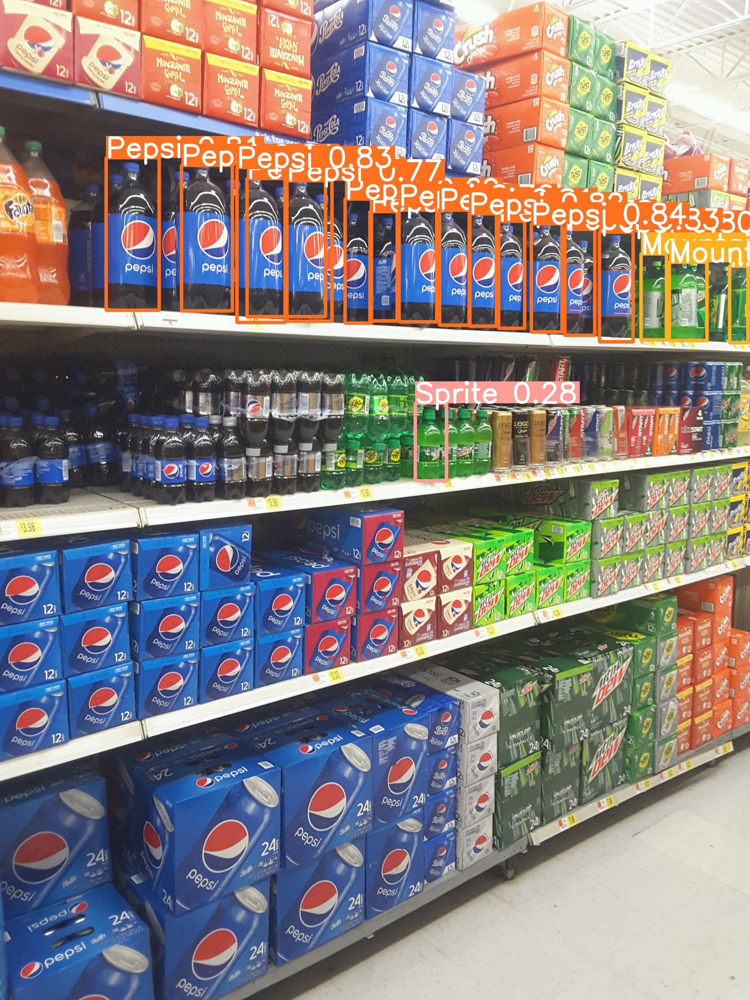

In [ ]:
# Results
results.show() # or .show(), .save(), .crop(), .pandas(), etc.

In [31]:
results.xyxy[0]  # im predictions (tensor)
df=results.pandas().xyxy[0]
results.pandas().xyxy[0]

,xmin,ymin,xmax,ymax,confidence,class,name
0,1734.281006,730.640747,1834.010010,1083.303223,0.843554,2,Pepsi
1,773.425171,546.979919,930.614990,1052.338501,0.834016,2,Pepsi
2,1843.551270,748.952454,1941.921753,1094.339111,0.831123,2,Pepsi
3,1531.863647,697.285400,1620.814209,1064.061279,0.824465,2,Pepsi
4,592.086670,539.906067,758.024841,1014.898804,0.813397,2,Pepsi
5,346.902252,514.978699,519.987488,1012.698364,0.811942,2,Pepsi
6,1434.955322,683.107544,1533.023560,1061.143677,0.809531,2,Pepsi
7,1956.874878,757.716064,2066.897217,1115.498413,0.800362,2,Pepsi
8,1627.600708,721.884949,1712.755493,1071.584839,0.778967,2,Pepsi
9,936.715698,589.022827,1083.619629,1048.892822,0.772007,2,Pepsi


In [52]:
x=df['name'].unique()
print(x)

['Pepsi' 'Mountain_Dew' 'Sprite']


In [42]:
import pandas as pd
data = pd.read_csv("drink.csv")
data

,class_name,Review,Carbon_dioxide,Rating,Preservatives
0,Coca_cola,"The caffeine amount in this is very high, whic...",200.5,2.7,58
1,Sprite,level of chemicals more than required,320.0,3.5,152
2,Pepsi,its have a very much gas and its to hard for d...,143.0,2.6,101
3,Mountain_Dew,Mountain Dew is basically a soft drink with ad...,109.7,3.4,165
4,7UP,I am a fan of the 7 Up of my childhood. Then s...,118.0,3.3,75
5,Fanta,Coldrink fanta is very very bad taste it is no...,105.0,2.6,174


In [59]:
df1=data.sort_values(['Rating'], axis=0, ascending=False, inplace=False, kind='quicksort', na_position='last')
df1.loc[df1['class_name'].isin(x)]

,class_name,Review,Carbon_dioxide,Rating,Preservatives
1,Sprite,level of chemicals more than required,320.0,3.5,152
3,Mountain_Dew,Mountain Dew is basically a soft drink with ad...,109.7,3.4,165
2,Pepsi,its have a very much gas and its to hard for d...,143.0,2.6,101


In [57]:
df2=data.sort_values(['Carbon_dioxide'], axis=0, ascending=True, inplace=False, kind='quicksort', na_position='last')
df2.loc[df2['class_name'].isin(x)]

,class_name,Review,Carbon_dioxide,Rating,Preservatives
3,Mountain_Dew,Mountain Dew is basically a soft drink with ad...,109.7,3.4,165
2,Pepsi,its have a very much gas and its to hard for d...,143.0,2.6,101
1,Sprite,level of chemicals more than required,320.0,3.5,152


In [58]:
df3=data.sort_values(['Preservatives'], axis=0, ascending=True, inplace=False, kind='quicksort', na_position='last')
df3.loc[df3['class_name'].isin(x)]

,class_name,Review,Carbon_dioxide,Rating,Preservatives
2,Pepsi,its have a very much gas and its to hard for d...,143.0,2.6,101
1,Sprite,level of chemicals more than required,320.0,3.5,152
3,Mountain_Dew,Mountain Dew is basically a soft drink with ad...,109.7,3.4,165
